In [2]:
import os
import json

import matplotlib.pyplot as plt
import pandas as pd
from collections import defaultdict

In [3]:
from matplotlib import rcParams

rcParams['font.family'] = 'Malgun Gothic'
rcParams['axes.unicode_minus'] = False

### bbox 누락 확인

In [4]:
data_dir = '../data'
anno_dir = '../data/train_annotations'

stats = defaultdict(lambda: {'valid': 0, 'missing': 0})
anno_count = 0

for root, dirs, files in os.walk(anno_dir):
    for file in files:
        if not file.endswith('.json'):
            continue
        
        anno_count += 1
        with open(os.path.join(root, file), 'r', encoding='utf-8') as f:
            data = json.load(f)

            if 'annotations' in data:
                name = {c["id"]: c["name"] for c in data["categories"]}

                for ann in data['annotations']:
                    cid = ann['category_id']
                    cname = name.get(cid, f'unk_{cid}')

                    bbox = ann.get('bbox', [])

                    if isinstance(bbox, list) and len(bbox) == 4:
                        stats[cname]['valid'] += 1
                    else:
                        stats[cname]['missing'] += 1

results = [(cname, v['valid'], v['missing']) for cname, v in stats.items()]
df = pd.DataFrame(results, columns=['name', 'valid', 'missing'])
df

,name,valid,missing
0,보령부스파정 5mg,180,0
1,동아가바펜틴정 800mg,139,0
2,낙소졸정 500/20mg,35,0
3,신바로정,35,0
4,가바토파정 100mg,143,0
...,...,...,...
68,쿠에타핀정 25mg,10,0
69,졸로푸트정 100mg,11,0
70,렉사프로정 15mg,9,0
71,브린텔릭스정 20mg,7,0


In [5]:
df[df['missing'] > 0]

,name,valid,missing


In [6]:
print(anno_count)

4526


조금 더 자세히 보긴 해야겠지만, bbox 자체가 누락이 된건 없어보임.

아마 bbox 겹침때문에 누락 처럼 보이지 않았나 싶은데, 좀 더 확인 예정.

### 어노테이션 누락

확인 결과 bbox자체의 누락이 아닌 annotation 파일 자체가 없어서 bbox가 인식되지 않는 문제로 확인됨

우선 데이터의 분포를 확인해보면 70도 75도 90도에서 찍힌 같은 구도의 사진이 존재하며, 70도만 180도로 돌아가 있음  
이 점을 고려하여 annotation에는 각 약의 폴더마다 70, 75, 90 세개의 annotation이 무조건 들어가 있을 것이라고 가정,  
만약 3개가 아닐경우 가장 가까운 annotation을 복사  
각도에 따라 약간의 bbox 틀어짐이 있을 수 있기 때문에 가장 각도의 크기가 적은 것을 기준으로 bbox를 복사하면 얼추 맞을것이라는 판단에 따라 진행하게됨

In [9]:

ANNO_DIR = "../data/train_annotations"  # 최상위 어노테이션 폴더 경로

def check_missing_annos_per_drug(anno_dir, expected_count=3):
    missing = []

    # 최상위 폴더 순회
    for root, dirs, files in os.walk(anno_dir):
        # leaf 폴더 (파일이 있고 json 포함)
        json_files = [f for f in files if f.endswith(".json")]
        if json_files:
            drug_name = os.path.basename(root)  # 예: K-001900, K-016548
            count = len(json_files)
            if count != expected_count:
                missing.append({
                    "folder": root,
                    "drug": drug_name,
                    "count": count,
                    "missing": expected_count - count
                })

    return pd.DataFrame(missing)

# 실행
df_missing = check_missing_annos_per_drug(ANNO_DIR, expected_count=3)

print(f"❌ 어노테이션이 누락된 약 폴더 수: {len(df_missing)}")
df_missing.head(20)

❌ 어노테이션이 누락된 약 폴더 수: 935


,folder,drug,count,missing
0,../data/train_annotations\K-001900-010224-0165...,K-031705,2,1
1,../data/train_annotations\K-001900-010224-0165...,K-016551,2,1
2,../data/train_annotations\K-001900-010224-0165...,K-033009,2,1
3,../data/train_annotations\K-001900-016548-0181...,K-018110,2,1
4,../data/train_annotations\K-001900-016548-0181...,K-021026,2,1
5,../data/train_annotations\K-001900-016548-0181...,K-016548,2,1
6,../data/train_annotations\K-001900-016548-0181...,K-018110,2,1
7,../data/train_annotations\K-001900-016548-0181...,K-018110,2,1
8,../data/train_annotations\K-001900-016548-0181...,K-018110,2,1
9,../data/train_annotations\K-001900-016548-0181...,K-029451,2,1


In [15]:
import os, json

def rotate_bbox_180(bbox, img_w, img_h):
    x, y, w, h = bbox
    x_new = img_w - (x + w)
    y_new = img_h - (y + h)
    return [x_new, y_new, w, h]

def fill_missing_annotations(root_dir):
    required_angles = ["70", "75", "90"]
    filled = []

    # 모든 하위 폴더까지 탐색
    for root, dirs, files in os.walk(root_dir):
        json_files = [f for f in files if f.endswith(".json")]
        if not json_files:
            continue

        print(json_files)

        angles = []
        for f in json_files:
            parts = f.split("_")
            for p in parts:
                if p in ["70", "75", "90"]:
                    angles.append(p)
                    break


        # 누락된 angle 찾아 처리
        if "70" not in angles and "75" in angles:
            template_angle, target_angle, need_rotation = "75", "70", True
        elif "75" not in angles:
            if "70" in angles:  # 75는 70 기반
                template_angle, target_angle, need_rotation = "70", "75", True
            elif "90" in angles:  # 75는 90 기반
                template_angle, target_angle, need_rotation = "90", "75", False
            else:
                continue
        elif "90" not in angles and "75" in angles:
            template_angle, target_angle, need_rotation = "75", "90", False
        else:
            continue  # 누락 없음

        # 템플릿 파일 선택
        template_file = None
        for f in json_files:
            if f"_{template_angle}_" in f:
                template_file = os.path.join(root, f)
                break
        if not template_file:
            continue

        # JSON 읽기
        with open(template_file, "r", encoding="utf-8") as f:
            data = json.load(f)

        img_w = data["images"][0]["width"]
        img_h = data["images"][0]["height"]

        # images 수정
        data["images"][0]["file_name"] = data["images"][0]["file_name"].replace(f"_{template_angle}_", f"_{target_angle}_")
        data["images"][0]["camera_la"] = int(target_angle)

        # annotations 수정 (필요시 bbox 회전)
        if need_rotation:
            for ann in data["annotations"]:
                ann["bbox"] = rotate_bbox_180(ann["bbox"], img_w, img_h)

        # 새 JSON 저장
        new_file = template_file.replace(f"_{template_angle}_", f"_{target_angle}_")
        with open(new_file, "w", encoding="utf-8") as f:
            json.dump(data, f, ensure_ascii=False, indent=2)

        filled.append(new_file)
        print(f"✅ 채움: {new_file} (회전 적용={need_rotation})")
        with open("filled_json_list.txt", "w", encoding="utf-8") as f:
            for path in filled:
                f.write(path + "\n")

    print(f"\n총 {len(filled)}개 json 생성 완료")

In [16]:
anno_test_dir = '../data/train_annotations_test'

fill_missing_annotations(anno_test_dir)

['K-001866-013395-022627-044834_0_2_0_2_70_000_200.json', 'K-001866-013395-022627-044834_0_2_0_2_75_000_200.json', 'K-001866-013395-022627-044834_0_2_0_2_90_000_200.json']
['K-001866-013395-022627-044834_0_2_0_2_70_000_200.json', 'K-001866-013395-022627-044834_0_2_0_2_75_000_200.json', 'K-001866-013395-022627-044834_0_2_0_2_90_000_200.json']
['K-001866-013395-022627-044834_0_2_0_2_70_000_200.json', 'K-001866-013395-022627-044834_0_2_0_2_75_000_200.json', 'K-001866-013395-022627-044834_0_2_0_2_90_000_200.json']
['K-001866-013395-022627-044834_0_2_0_2_70_000_200.json', 'K-001866-013395-022627-044834_0_2_0_2_75_000_200.json', 'K-001866-013395-022627-044834_0_2_0_2_90_000_200.json']
['K-001866-013395-023223-037777_0_2_0_2_70_000_200.json', 'K-001866-013395-023223-037777_0_2_0_2_75_000_200.json', 'K-001866-013395-023223-037777_0_2_0_2_90_000_200.json']
['K-001866-013395-023223-037777_0_2_0_2_70_000_200.json', 'K-001866-013395-023223-037777_0_2_0_2_75_000_200.json', 'K-001866-013395-023223-0

### pseudo-labeling

기존에 해당 데이터로 학습을 진행했던 YOLOv12의 best모델을 가져와서, 모델이 bbox를 예측하게 하고, 모델이 예측한 bbox와 현재 새로 생성된 json의 bbox의 iou를 비교하여  
bbox의 틀어짐을 보정

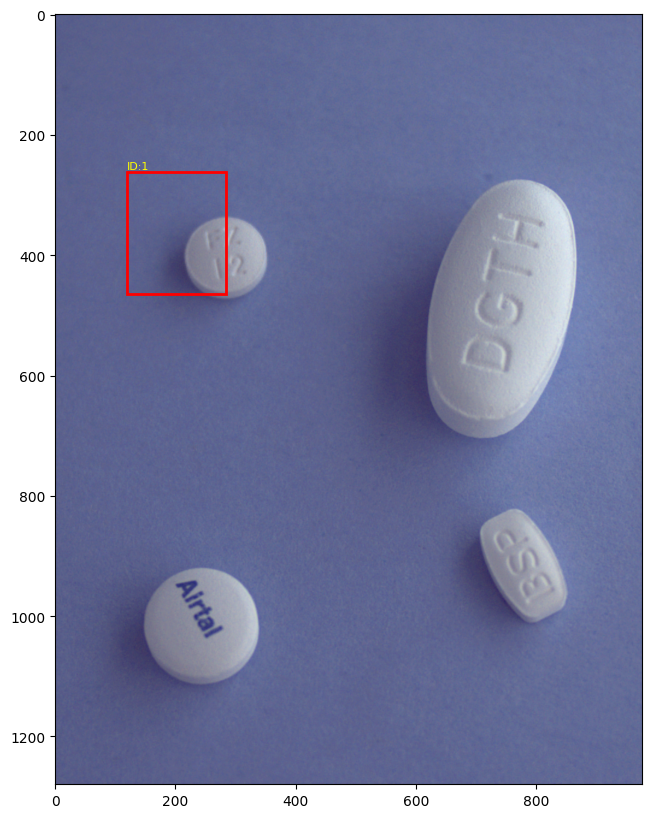

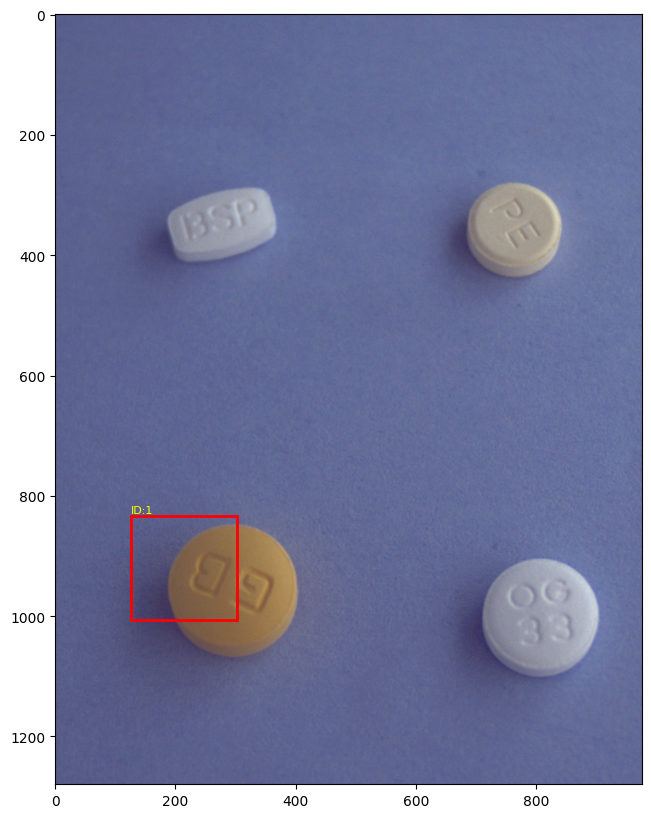

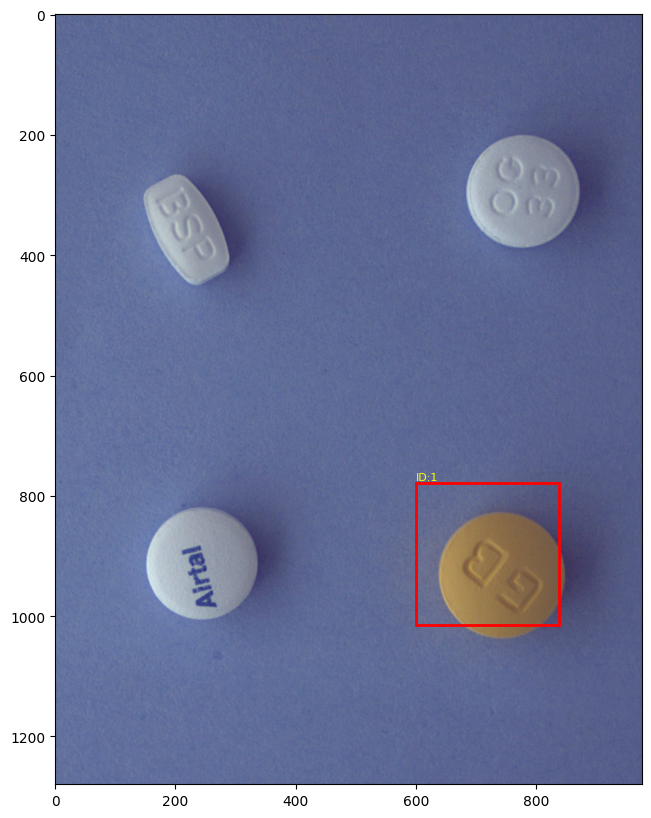

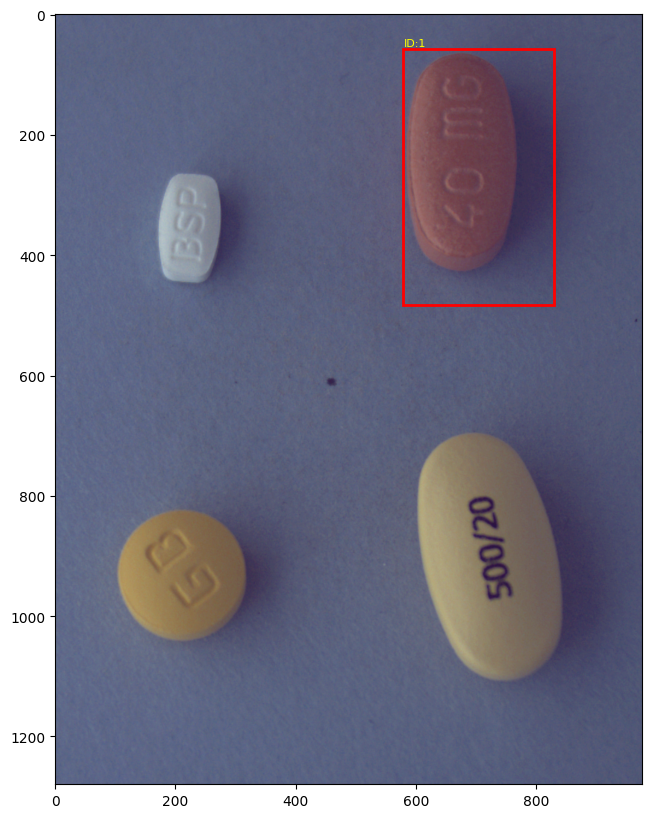

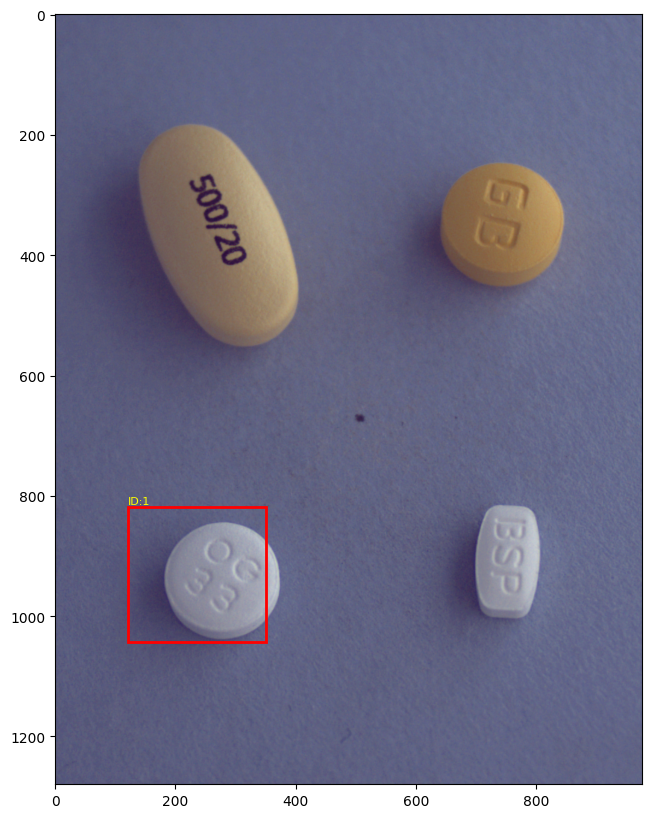

In [17]:
import os, json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def visualize_json_bbox(json_path, img_root):
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)

    img_info = data["images"][0]
    img_file = os.path.join(img_root, img_info["file_name"])
    img = Image.open(img_file)

    fig, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(img)

    for ann in data["annotations"]:
        x, y, w, h = ann["bbox"]
        rect = patches.Rectangle((x, y), w, h, linewidth=2,
                                 edgecolor="r", facecolor="none")
        ax.add_patch(rect)
        ax.text(x, y-5, f"ID:{ann['category_id']}", color="yellow", fontsize=8)

    plt.show()

# 사용 예시
img_root = "../data/train_images"
with open("filled_json_list.txt", "r", encoding="utf-8") as f:
    filled_files = [line.strip() for line in f.readlines()]

# 채운 json 중 5개만 랜덤 확인
import random
for json_path in random.sample(filled_files, 5):
    visualize_json_bbox(json_path, img_root)


In [18]:
from ultralytics import YOLO

model = YOLO("..//v12_runs/train/weights/best.pt")

In [19]:
def load_filled_json_list(list_path):
    with open(list_path, "r", encoding="utf-8") as f:
        return [line.strip() for line in f if line.strip()]

In [20]:
def correct_bboxes_with_yolo(img_path, json_path, model, conf=0.25, iou_thr=0.5):
    # YOLO 추론
    results = model.predict(img_path, conf=conf, verbose=False)
    preds = results[0].boxes.xywh.cpu().tolist()   # [x_center, y_center, w, h]

    # JSON 로드
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)

    anns = data.get("annotations", [])
    corrected = []

    for ann in anns:
        x, y, w, h = ann["bbox"]
        ann_box = [x, y, w, h]

        # 기존 박스를 YOLO 예측과 IoU 비교
        best_iou, best_box = 0, None
        for px, py, pw, ph in preds:
            pred_box = [px - pw/2, py - ph/2, pw, ph]  # x,y,w,h
            iou = bbox_iou(ann_box, pred_box)
            if iou > best_iou:
                best_iou, best_box = iou, pred_box

        # IoU가 충분하면 교정
        if best_box and best_iou < iou_thr:
            ann["bbox"] = best_box
            corrected.append((ann["id"], best_iou))

    # JSON 저장
    with open(json_path, "w", encoding="utf-8") as f:
        json.dump(data, f, ensure_ascii=False, indent=2)

    return corrected

def bbox_iou(box1, box2):
    # [x,y,w,h] → [x1,y1,x2,y2]
    def to_xyxy(b):
        return [b[0], b[1], b[0]+b[2], b[1]+b[3]]
    b1 = to_xyxy(box1)
    b2 = to_xyxy(box2)

    inter_x1 = max(b1[0], b2[0])
    inter_y1 = max(b1[1], b2[1])
    inter_x2 = min(b1[2], b2[2])
    inter_y2 = min(b1[3], b2[3])

    if inter_x2 < inter_x1 or inter_y2 < inter_y1:
        return 0.0

    inter_area = (inter_x2 - inter_x1) * (inter_y2 - inter_y1)
    area1 = (b1[2]-b1[0]) * (b1[3]-b1[1])
    area2 = (b2[2]-b2[0]) * (b2[3]-b2[1])
    union = area1 + area2 - inter_area

    return inter_area / union if union > 0 else 0



In [21]:
img_dir = "../data/train_images"
list_path = "filled_json_list.txt"
json_files = load_filled_json_list(list_path)

for json_path in json_files:
    if not os.path.exists(json_path):
        print(f"⚠️ 없는 파일: {json_path}")
        continue

    # JSON에서 이미지 이름 추출
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)
    img_file = data["images"][0]["file_name"]
    img_path = os.path.join(img_dir, img_file)

    if not os.path.exists(img_path):
        print(f"⚠️ 이미지 없음: {img_file}")
        continue

    corrected = correct_bboxes_with_yolo(img_path, json_path, model)
    if corrected:
        print(f"🔧 {json_path}: {len(corrected)}개 bbox 교정됨 → {corrected}")

🔧 ../data/train_annotations_test\K-001900-003544-016548-021026_json\K-021026\K-001900-003544-016548-021026_0_2_0_2_70_000_200 copy 2.json: 1개 bbox 교정됨 → [(1, 0.3204514533374177)]
🔧 ../data/train_annotations_test\K-001900-003544-016551-029451_json\K-001900\K-001900-003544-016551-029451_0_2_0_2_70_000_200.json: 1개 bbox 교정됨 → [(1, 0.3502032111165674)]
🔧 ../data/train_annotations_test\K-001900-004543-016551-019607_json\K-001900\K-001900-004543-016551-019607_0_2_0_2_70_000_200 copy.json: 1개 bbox 교정됨 → [(1, 0.22262007206305273)]
🔧 ../data/train_annotations_test\K-001900-006563-016548-019607_json\K-006563\K-001900-006563-016548-019607_0_2_0_2_70_000_200 copy.json: 1개 bbox 교정됨 → [(1, 0.335288477061034)]


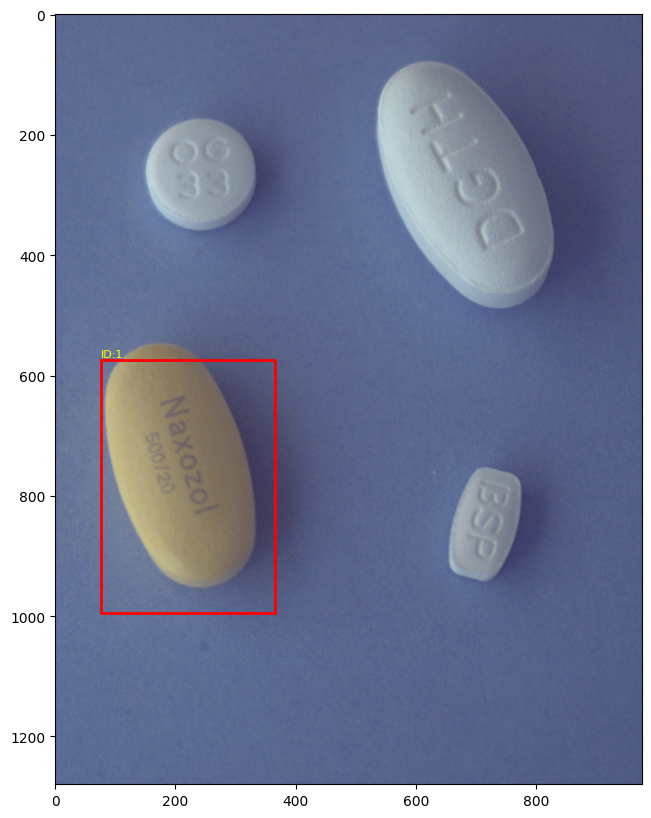

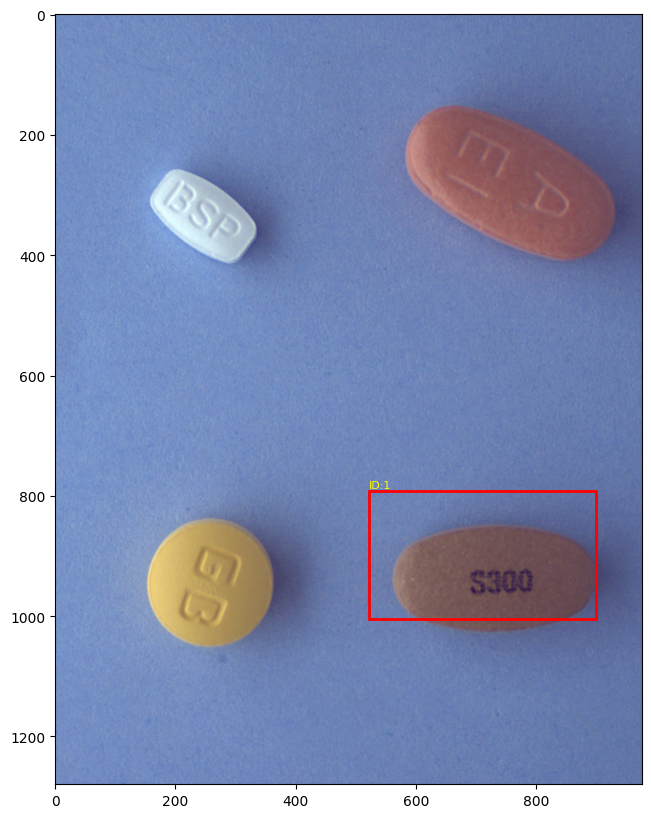

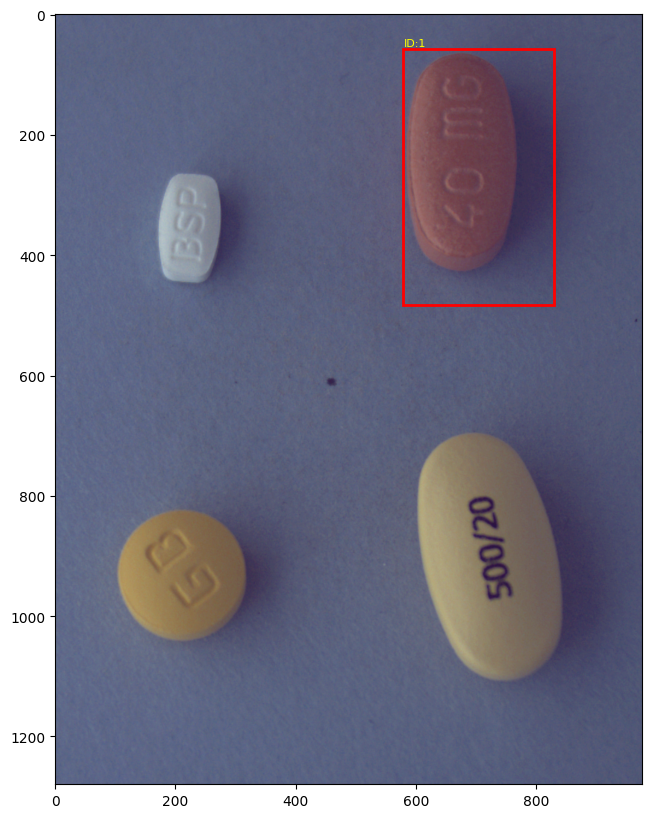

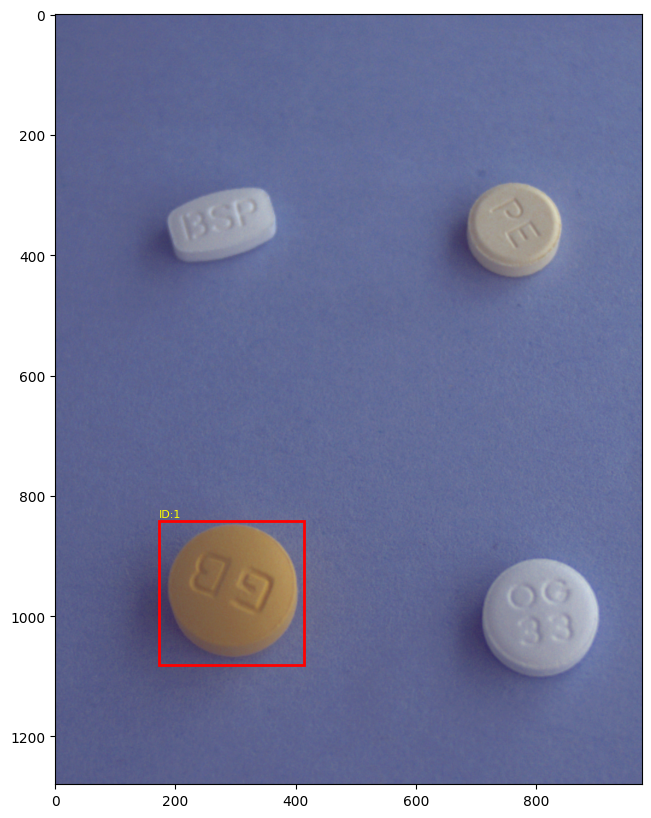

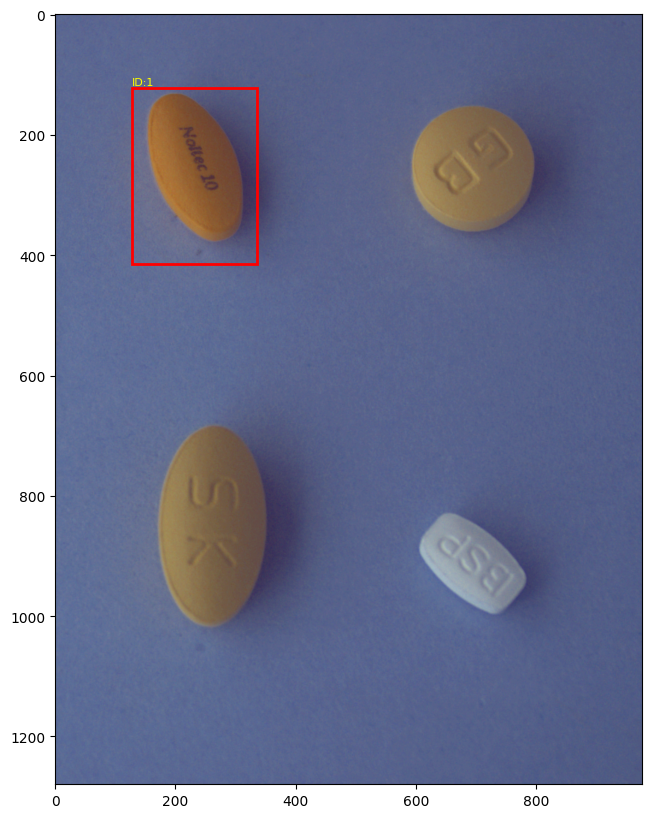

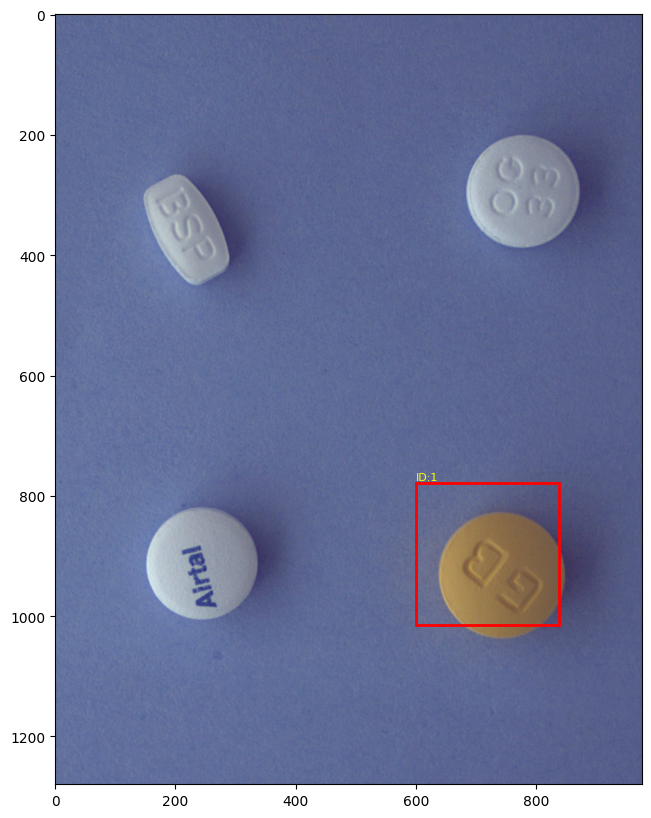

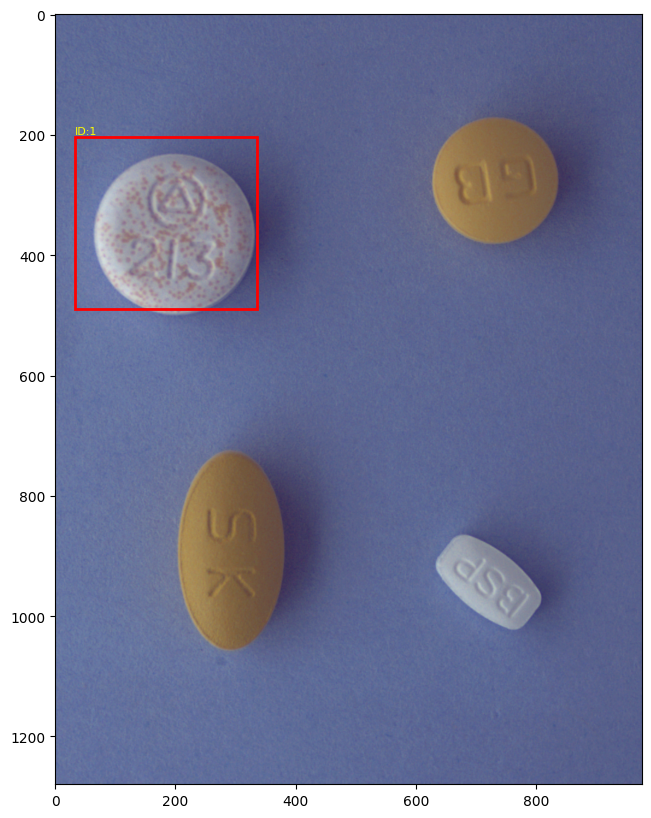

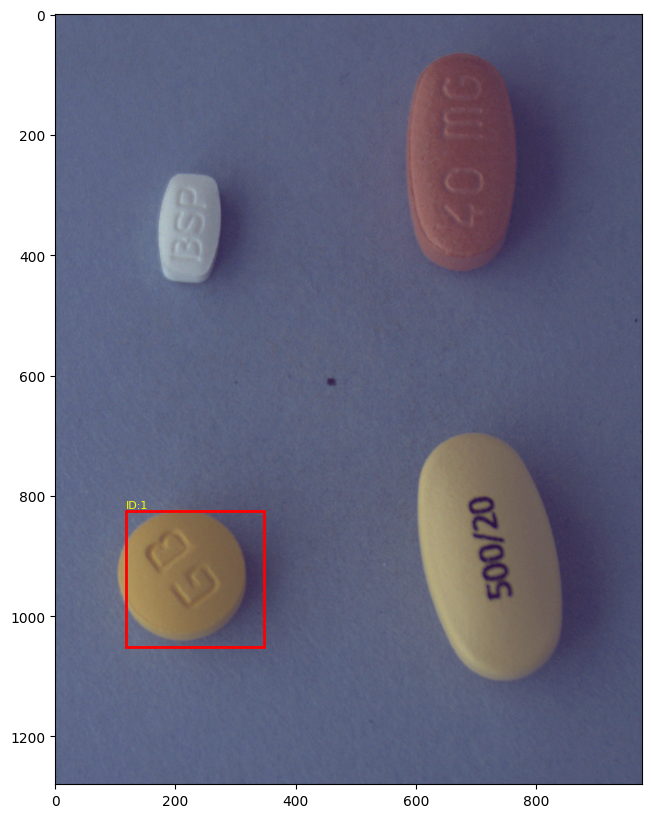

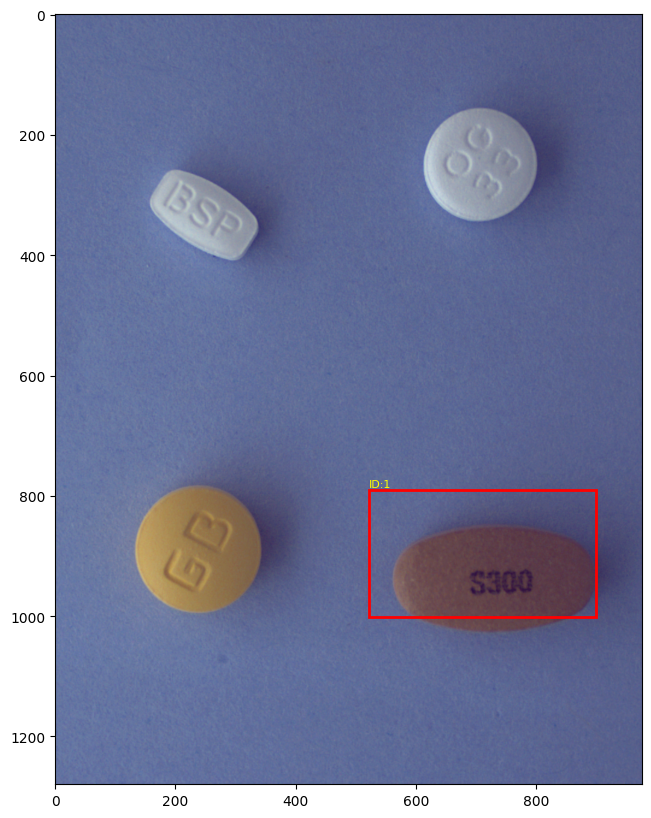

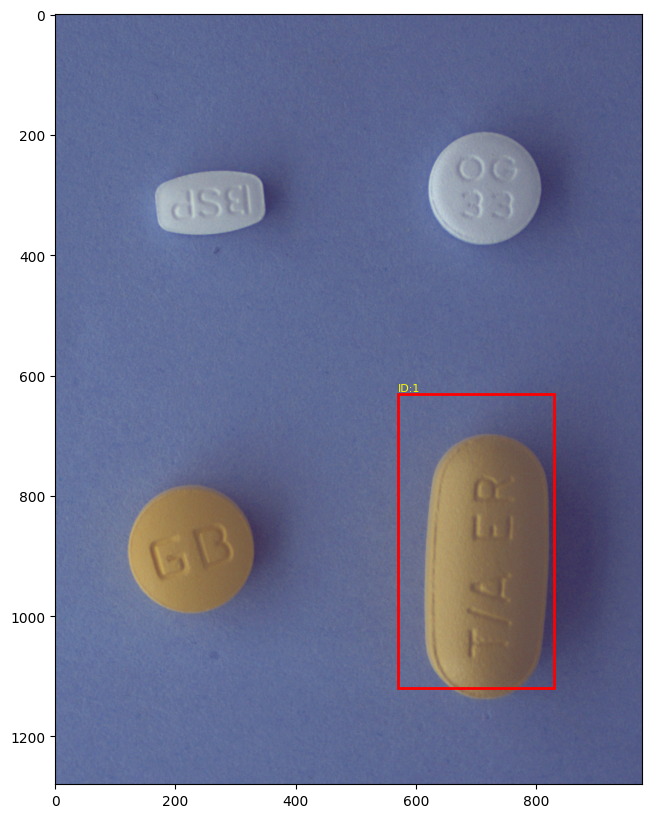

In [22]:
import os, json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def visualize_json_bbox(json_path, img_root):
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)

    img_info = data["images"][0]
    img_file = os.path.join(img_root, img_info["file_name"])

    # 이미지 파일이 없으면 그냥 함수 종료
    if not os.path.exists(img_file):
        print(f"[WARN] 이미지 없음 → {img_file}")
        return False

    img = Image.open(img_file)

    fig, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(img)

    for ann in data["annotations"]:
        x, y, w, h = ann["bbox"]
        rect = patches.Rectangle((x, y), w, h, linewidth=2,
                                 edgecolor="r", facecolor="none")
        ax.add_patch(rect)
        ax.text(x, y-5, f"ID:{ann['category_id']}", color="yellow", fontsize=8)

    plt.show()
    return True


# 사용 예시
img_root = "../data/train_images"
with open("filled_json_list.txt", "r", encoding="utf-8") as f:
    filled_files = [line.strip() for line in f.readlines()]

import random
for json_path in random.sample(filled_files, 10):
    ok = visualize_json_bbox(json_path, img_root)
    if not ok:  # 이미지 없으면 그냥 넘어감
        continue

### Pseudo-Labeling 결과

괜찮게 맞는 bbox가 존재하긴 했지만, 아직 많이 틀어진 것들이 보여서 좀 더 정교화 방법이 있는지 찾아보기로 함

### ciou 지표

일반 iou를 기준으로 bbox를 보정하기 보다는 ciou를 기준으로 bbox를 보정하기로 함

ciou: complete iou라는 의미로 iou처럼 bbox의 겹침만을 확인하는 것이 아닌 bbox 중심점까지의 거리, bbox의 가로와 세로 비율까지 regression을 진행하여 조금 더 정교한 bbox regression을 기대할 수 있음

In [23]:
def bbox_ciou(box1, box2):
    # [x,y,w,h] → [x1,y1,x2,y2]
    def to_xyxy(b):
        return [b[0], b[1], b[0]+b[2], b[1]+b[3]]
    b1, b2 = to_xyxy(box1), to_xyxy(box2)

    inter_x1 = max(b1[0], b2[0])
    inter_y1 = max(b1[1], b2[1])
    inter_x2 = min(b1[2], b2[2])
    inter_y2 = min(b1[3], b2[3])
    inter = max(0, inter_x2-inter_x1) * max(0, inter_y2-inter_y1)

    area1 = (b1[2]-b1[0]) * (b1[3]-b1[1])
    area2 = (b2[2]-b2[0]) * (b2[3]-b2[1])
    union = area1 + area2 - inter
    iou = inter / union if union > 0 else 0

    # 중심점 거리
    cx1, cy1 = (b1[0]+b1[2])/2, (b1[1]+b1[3])/2
    cx2, cy2 = (b2[0]+b2[2])/2, (b2[1]+b2[3])/2
    center_dist = (cx1-cx2)**2 + (cy1-cy2)**2

    # 가장 작은 외접 박스
    cw = max(b1[2], b2[2]) - min(b1[0], b2[0])
    ch = max(b1[3], b2[3]) - min(b1[1], b2[1])
    c_diag = cw**2 + ch**2

    # DIoU
    diou = iou - (center_dist / (c_diag + 1e-7))
    return diou

In [12]:
def correct_bboxes_with_yolo_ciou(img_path, json_path, model, conf=0.25, iou_thr=0.5):
    # YOLO 추론
    results = model.predict(img_path, conf=conf, verbose=False)

    preds = []
    for box in results[0].boxes:
        px, py, pw, ph = box.xywh.cpu().tolist()[0]
        conf_pred = box.conf.cpu().item()
        preds.append((px, py, pw, ph, conf_pred))

    # JSON 로드
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)

    anns = data.get("annotations", [])
    corrected = []

    for ann in anns:
        x, y, w, h = ann["bbox"]
        ann_box = [x, y, w, h]

        best_score, best_box = 0, None
        for px, py, pw, ph, conf_pred in preds:
            pred_box = [px - pw/2, py - ph/2, pw, ph]
            score = bbox_ciou(ann_box, pred_box) * conf_pred
            if score > best_score:
                best_score, best_box = score, pred_box

        # IoU/CIoU 스코어가 기준 이상이면 교정
        if best_box and best_score > iou_thr:
            ann["bbox"] = best_box
            corrected.append((ann["id"], best_score))

    # JSON 저장
    with open(json_path, "w", encoding="utf-8") as f:
        json.dump(data, f, ensure_ascii=False, indent=2)

    return corrected


In [24]:
img_dir = "../data/train_images"
list_path = "filled_json_list.txt"
json_files = load_filled_json_list(list_path)

for json_path in json_files:
    if not os.path.exists(json_path):
        print(f"⚠️ 없는 파일: {json_path}")
        continue

    # JSON에서 이미지 이름 추출
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)
    img_file = data["images"][0]["file_name"]
    img_path = os.path.join(img_dir, img_file)

    if not os.path.exists(img_path):
        print(f"⚠️ 이미지 없음: {img_file}")
        continue

    corrected = correct_bboxes_with_yolo_ciou(img_path, json_path, model)
    if corrected:
        print(f"🔧 {json_path}: {len(corrected)}개 bbox 교정됨 → {corrected}")

🔧 ../data/train_annotations_test\K-001900-003544-004543-016548_json\K-016548\K-001900-003544-004543-016548_0_2_0_2_90_000_200 copy.json: 1개 bbox 교정됨 → [(1, 0.5562375389506095)]
🔧 ../data/train_annotations_test\K-001900-003544-004543-016551_json\K-016551\K-001900-003544-004543-016551_0_2_0_2_90_000_200 copy.json: 1개 bbox 교정됨 → [(1, 0.6527546988767223)]
🔧 ../data/train_annotations_test\K-001900-003544-006563-016551_json\K-001900\K-001900-003544-006563-016551_0_2_0_2_90_000_200 copy.json: 1개 bbox 교정됨 → [(1, 0.5131770569411007)]
🔧 ../data/train_annotations_test\K-001900-003544-016548-021026_json\K-021026\K-001900-003544-016548-021026_0_2_0_2_70_000_200 copy 2.json: 1개 bbox 교정됨 → [(1, 0.937628448009491)]
🔧 ../data/train_annotations_test\K-001900-003544-016548-027926_json\K-027926\K-001900-003544-016548-027926_0_2_0_2_90_000_200 copy 2.json: 1개 bbox 교정됨 → [(1, 0.6404786795467098)]
🔧 ../data/train_annotations_test\K-001900-003544-016548-029345_json\K-016548\K-001900-003544-016548-029345_0_2_0

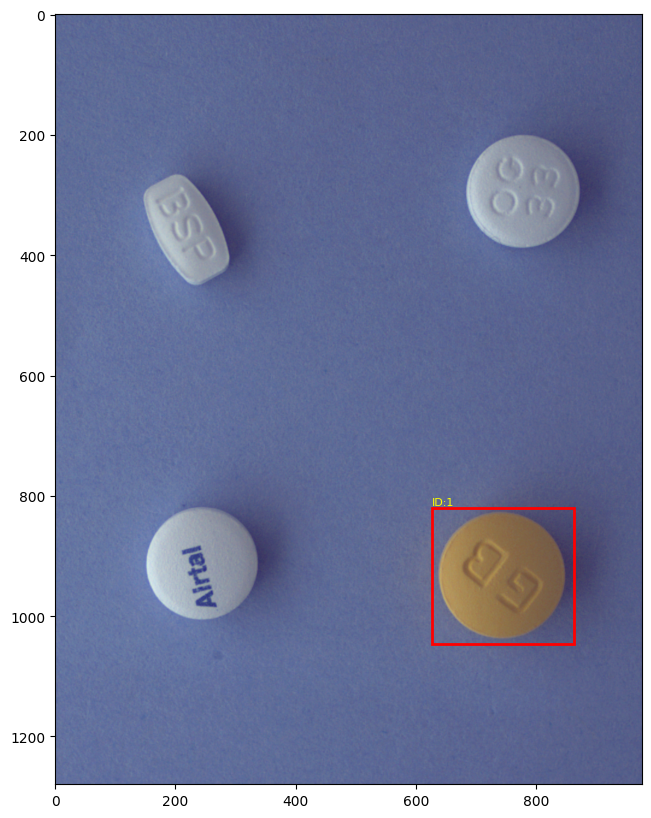

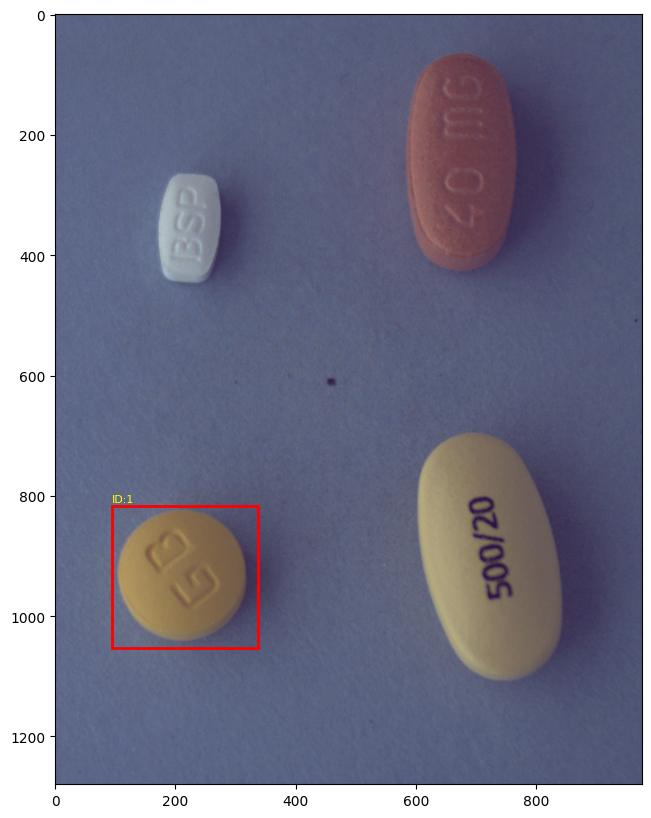

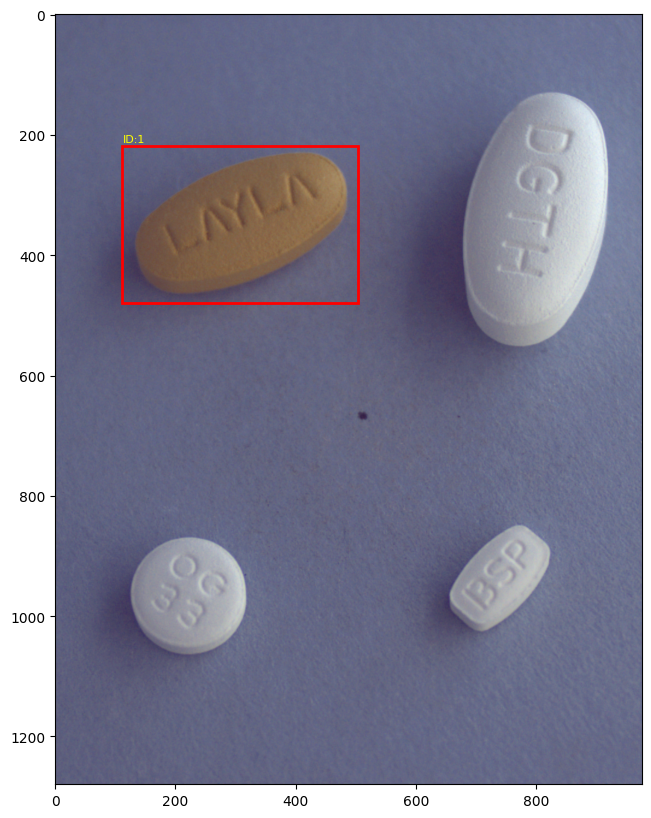

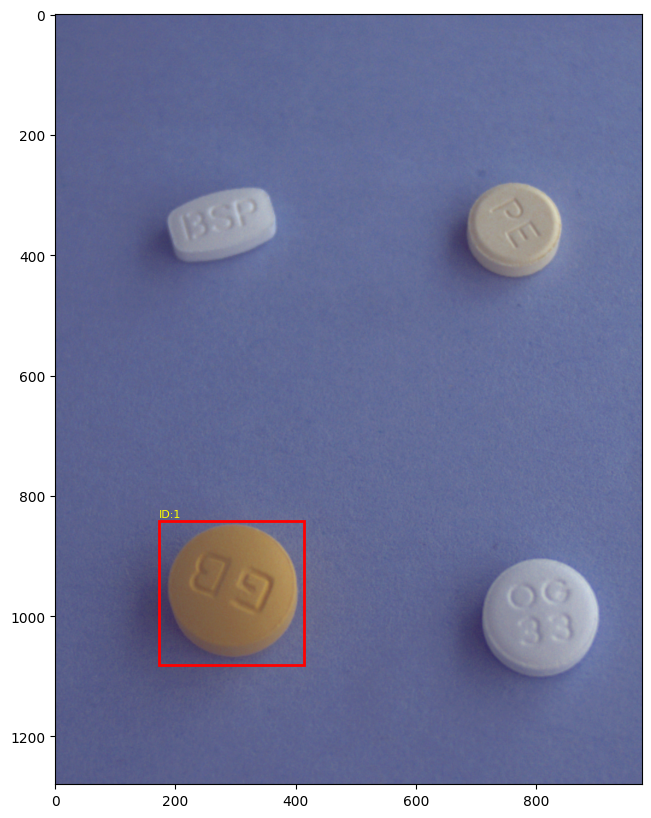

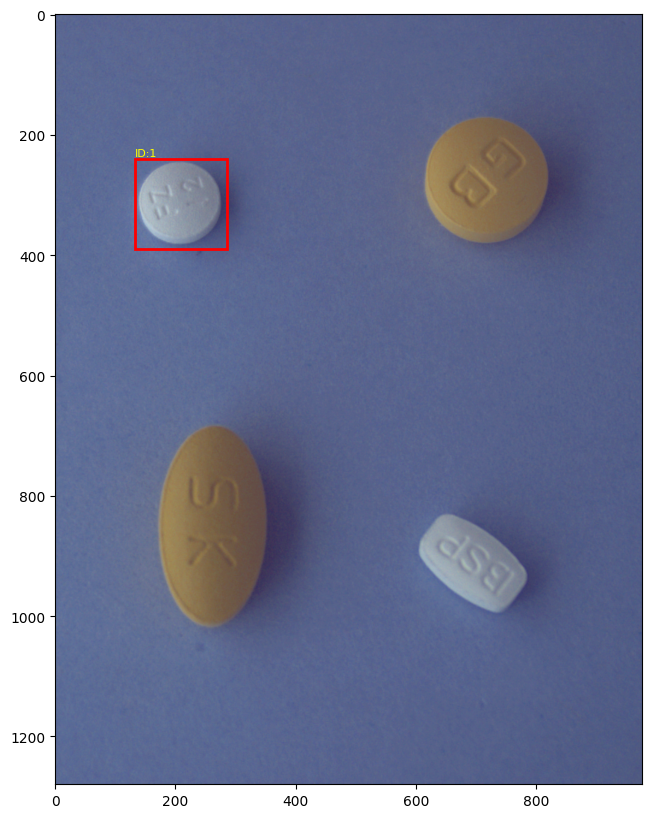

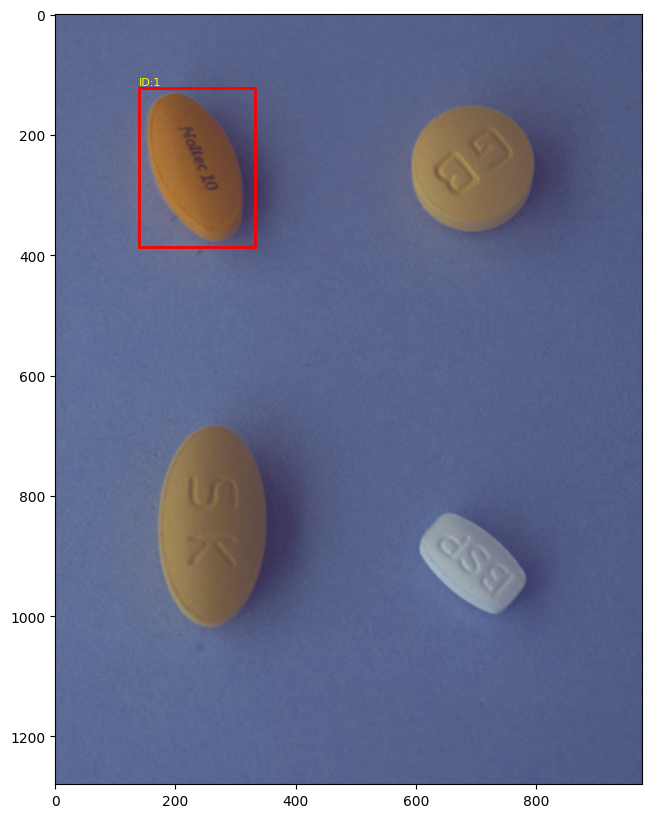

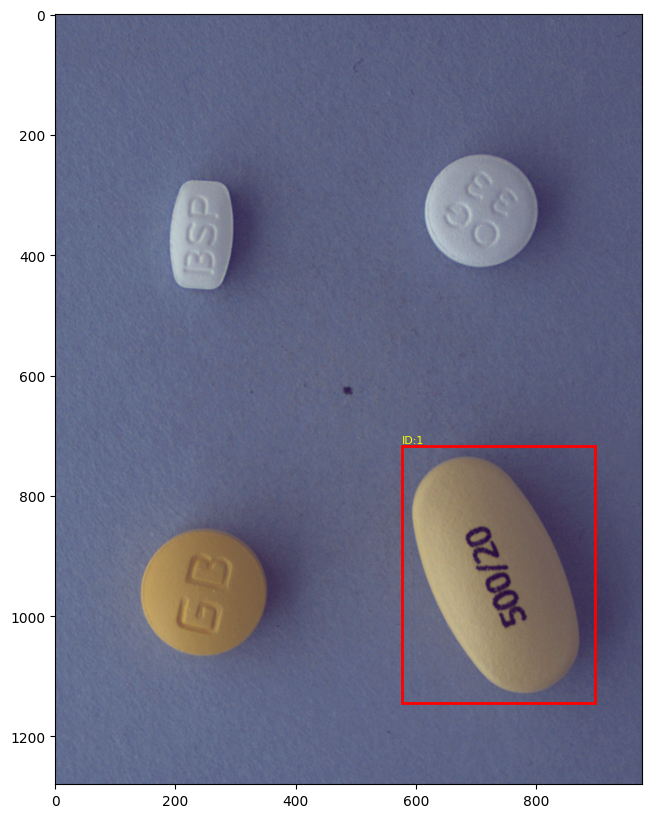

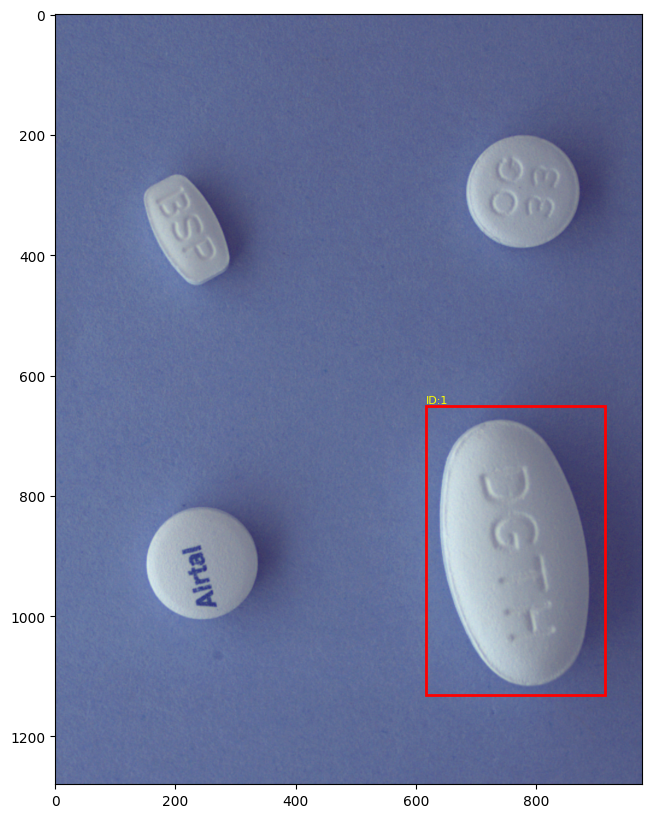

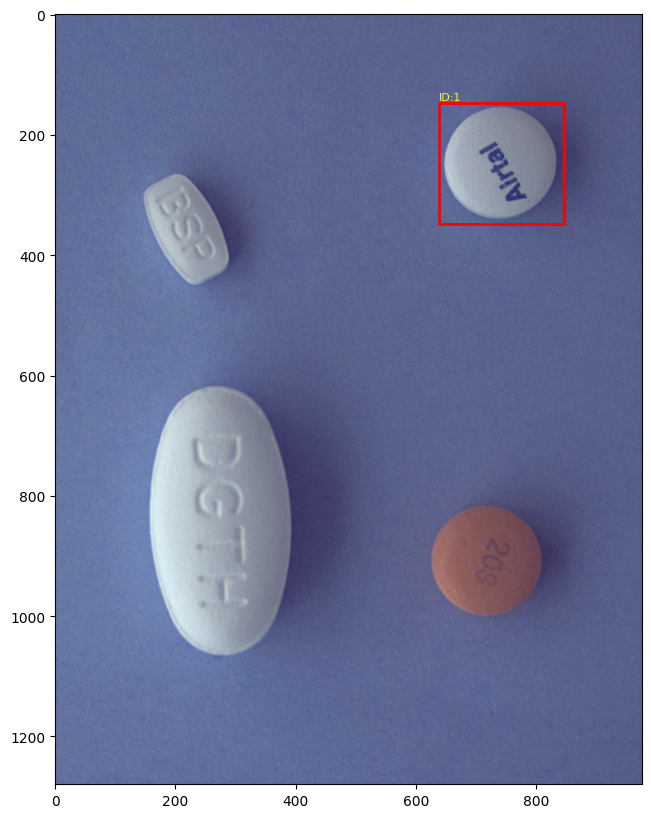

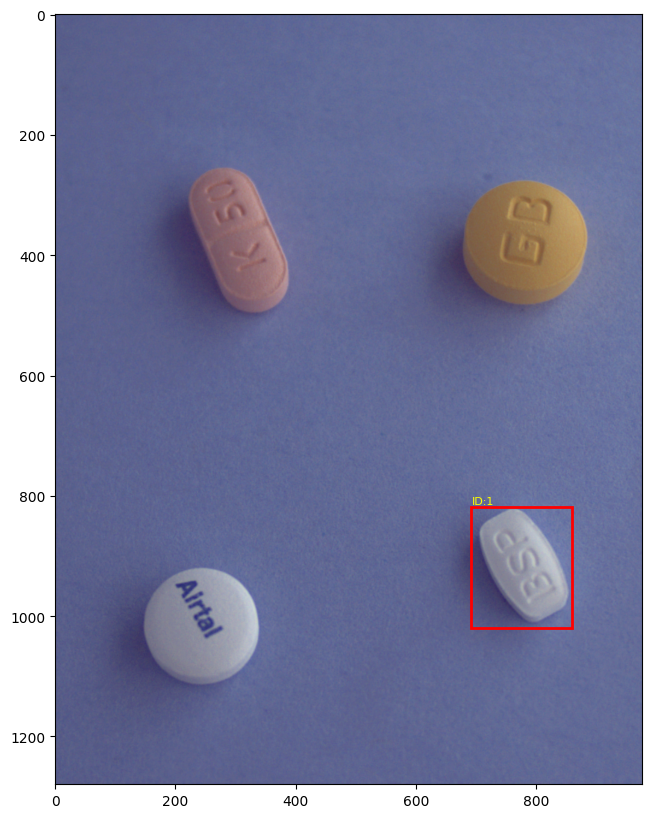

In [25]:
import os, json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def visualize_json_bbox(json_path, img_root):
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)

    img_info = data["images"][0]
    img_file = os.path.join(img_root, img_info["file_name"])

    # 이미지 파일이 없으면 그냥 함수 종료
    if not os.path.exists(img_file):
        print(f"[WARN] 이미지 없음 → {img_file}")
        return False

    img = Image.open(img_file)

    fig, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(img)

    for ann in data["annotations"]:
        x, y, w, h = ann["bbox"]
        rect = patches.Rectangle((x, y), w, h, linewidth=2,
                                 edgecolor="r", facecolor="none")
        ax.add_patch(rect)
        ax.text(x, y-5, f"ID:{ann['category_id']}", color="yellow", fontsize=8)

    plt.show()
    return True


# 사용 예시
img_root = "../data/train_images"
with open("filled_json_list.txt", "r", encoding="utf-8") as f:
    filled_files = [line.strip() for line in f.readlines()]

import random
for json_path in random.sample(filled_files, 10):
    ok = visualize_json_bbox(json_path, img_root)
    if not ok:  # 이미지 없으면 그냥 넘어감
        continue

### ciou 결과

그냥 iou 기준으로 보정한 결과 보다 훨씬 정교하게 bbox를 보정한 것을 확인할 수 있음

In [42]:
def filter_matching_annotation_folders(image_folder, annotation_parent_folder):
    # 이미지 폴더에서 모든 이미지 파일 가져오기
    image_files = [f for f in os.listdir(image_folder) if os.path.isfile(os.path.join(image_folder, f))]
    
    # 어노테이션 상위 폴더에서 모든 하위 폴더 가져오기
    annotation_folders = [f for f in os.listdir(annotation_parent_folder) if os.path.isdir(os.path.join(annotation_parent_folder, f))]
    
    # 이미지 파일명에서 '_' 앞부분 추출
    image_base_names = {}
    for img_file in image_files:
        if '_' in img_file:
            base_name = img_file.split('_')[0]
            image_base_names[base_name] = img_file
    
    # 어노테이션 폴더명에서 '_json' 앞부분 추출하고 일치하는 것만 필터링
    matching_folders = []
    for folder in annotation_folders:
        if '_json' in folder:
            base_name = folder.split('_json')[0]
            if base_name in image_base_names:
                matching_folders.append(folder)
    
    return matching_folders

origin_dir = '..'
img_dir = os.path.join(origin_dir, 'data/train_images')
anno_dir = os.path.join(origin_dir, 'data/train_annotations_test')

matching_folders = filter_matching_annotation_folders(img_dir, anno_dir)

# 결과 출력
print(f"일치하는 어노테이션 폴더 수: {len(matching_folders)}")
print("일치하는 폴더 목록:")
for folder in matching_folders:
    print(folder)

일치하는 어노테이션 폴더 수: 677
일치하는 폴더 목록:
K-001866-013395-022627-044834_json
K-001866-013395-023223-037777_json
K-001866-013395-023223-038954_json
K-001866-013395-023223-044834_json
K-001866-019552-022362-037777_json
K-001866-019552-022362-038954_json
K-001866-019552-022362-044834_json
K-001866-022362-022627-037777_json
K-001866-022362-022627-038954_json
K-001866-022362-022627-044834_json
K-001866-022362-023223-037777_json
K-001866-022362-023223-038954_json
K-001866-022362-023223-044834_json
K-001900-003544-004543-016548_json
K-001900-003544-004543-016551_json
K-001900-003544-006563-016548_json
K-001900-003544-006563-016551_json
K-001900-003544-016548-021026_json
K-001900-003544-016548-027926_json
K-001900-003544-016548-029345_json
K-001900-003544-016548-029451_json
K-001900-003544-016548-031705_json
K-001900-003544-016548-033009_json
K-001900-003544-016551-021026_json
K-001900-003544-016551-027926_json
K-001900-003544-016551-029345_json
K-001900-003544-016551-029451_json
K-001900-003544-016551

In [43]:
def get_jsonfiles(annotation_dir_path):
    """
    어노테이션 디렉토리 경로를 입력받아 해당 디렉토리 내의 모든 JSON 파일 경로를 반환합니다.
    
    Args:
        annotation_dir_path (str): 어노테이션 파일이 있는 디렉토리 경로
        
    Returns:
        list: JSON 파일의 전체 경로 목록
    """
    json_files = []
    
    # 디렉토리 존재 확인
    if not os.path.exists(annotation_dir_path):
        print(f"오류: 디렉토리가 존재하지 않습니다: {annotation_dir_path}")
        return json_files
    
    # 디렉토리 내 모든 파일과 하위 디렉토리를 순회
    for root, dirs, files in os.walk(annotation_dir_path):
        for file in files:
            if file.endswith('.json'):
                # JSON 파일의 전체 경로 추가
                json_path = os.path.join(root, file)
                json_files.append(json_path)
    
    print(f"총 {len(json_files)}개의 JSON 파일을 찾았습니다.")
    return json_files

In [44]:
img2json = defaultdict(list)
json_files = get_jsonfiles(anno_dir)

for jf in json_files:
    with open(jf, 'r', encoding='utf-8') as f:
        data = json.load(f)
    img_name = data['images'][0]['file_name']
    img2json[img_name].append(jf)
print('총 이미지 개수:', len(img2json))

총 7461개의 JSON 파일을 찾았습니다.
총 이미지 개수: 2031


In [45]:
def convert_jsons_to_txt(json_list, save_dir, class_map):
    '''
    YOLO txt 변환 함수
    '''
    if not json_list: return None
    with open(json_list[0], 'r', encoding='utf-8') as f:
        first_data = json.load(f)
    img = first_data['images'][0]
    img_w, img_h = img['width'], img['height']
    img_name = img['file_name']
    label_path = os.path.join(save_dir, img_name.replace('.png', '.txt'))

    yolo_lines = []
    for jf in json_list:
        with open(jf, 'r', encoding='utf-8') as f:
            data = json.load(f)
        

        for ann in data['annotations']:
            if 'bbox' not in ann or len(ann['bbox']) != 4:
                continue
            x, y, w, h = ann['bbox']
            x_center = (x + w / 2) / img_w
            y_center = (y + h / 2) / img_h
            w /= img_w
            h /= img_h

            name = data['images'][0]['dl_name']
            cls_id = class_map[name]

            yolo_lines.append(f'{cls_id} {x_center} {y_center} {w} {h}')

    if yolo_lines:
        with open(label_path, 'w', encoding='utf-8') as f:
            f.write('\n'.join(yolo_lines) + '\n')
    return img_name

In [46]:
# 학습/검증 데이터 분할
images = list(img2json.keys())
random.shuffle(images)
split_idx = int(len(images) * 0.8)
train_imgs, val_imgs = images[:split_idx], images[split_idx:]

print('Train 이미지:', len(train_imgs))
print('Val 이미지:', len(val_imgs))

Train 이미지: 1624
Val 이미지: 407


In [47]:
class_map = {'가바토파정 100mg': 0,
 '글리아타민연질캡슐': 1,
 '글리틴정(콜린알포세레이트)': 2,
 '기넥신에프정(은행엽엑스)(수출용)': 3,
 '낙소졸정 500/20mg': 4,
 '노바스크정 5mg': 5,
 '놀텍정 10mg': 6,
 '뉴로메드정(옥시라세탐)': 7,
 '다보타민큐정 10mg/병': 8,
 '동아가바펜틴정 800mg': 9,
 '라비에트정 20mg': 10,
 '란스톤엘에프디티정 30mg': 11,
 '레일라정': 12,
 '렉사프로정 15mg': 13,
 '로수바미브정 10/20mg': 14,
 '로수젯정10/5밀리그램': 15,
 '리렉스펜정 300mg/PTP': 16,
 '리리카캡슐 150mg': 17,
 '리바로정 4mg': 18,
 '리피로우정 20mg': 19,
 '리피토정 20mg': 20,
 '마도파정': 21,
 '맥시부펜이알정 300mg': 22,
 '메가파워정 90mg/병': 23,
 '무코스타정(레바미피드)(비매품)': 24,
 '뮤테란캡슐 100mg': 25,
 '보령부스파정 5mg': 26,
 '브린텔릭스정 20mg': 27,
 '비모보정 500/20mg': 28,
 '비타비백정 100mg/병': 29,
 '삐콤씨에프정 618.6mg/병': 30,
 '삼남건조수산화알루미늄겔정': 31,
 '세비카정 10/40mg': 32,
 '스토가정 10mg': 33,
 '신바로정': 34,
 '써스펜8시간이알서방정 650mg': 35,
 '쎄로켈정 100mg': 36,
 '아모잘탄정 5/100mg': 37,
 '아빌리파이정 10mg': 38,
 '아질렉트정(라사길린메실산염)': 39,
 '아토르바정 10mg': 40,
 '아토젯정 10/40mg': 41,
 '알드린정': 42,
 '에빅사정(메만틴염산염)(비매품)': 43,
 '에스원엠프정 20mg': 44,
 '에어탈정(아세클로페낙)': 45,
 '엑스포지정 5/160mg': 46,
 '오마코연질캡슐(오메가-3-산에틸에스테르90)': 47,
 '울트라셋이알서방정': 48,
 '일양하이트린정 2mg': 49,
 '자누메트엑스알서방정 100/1000mg': 50,
 '자누메트정 50/850mg': 51,
 '자누비아정 50mg': 52,
 '자이프렉사정 2.5mg': 53,
 '제미메트서방정 50/1000mg': 54,
 '조인스정 200mg': 55,
 '졸로푸트정 100mg': 56,
 '종근당글리아티린연질캡슐(콜린알포세레이트)\xa0': 57,
 '카나브정 60mg': 58,
 '카발린캡슐 25mg': 59,
 '케이캡정 50mg': 60,
 '콜리네이트연질캡슐 400mg': 61,
 '쿠에타핀정 25mg': 62,
 '큐시드정 31.5mg/PTP': 63,
 '크레스토정 20mg': 64,
 '타이레놀이알서방정(아세트아미노펜)(수출용)': 65,
 '타이레놀정500mg': 66,
 '트라젠타듀오정 2.5/850mg': 67,
 '트라젠타정(리나글립틴)': 68,
 '트루비타정 60mg/병': 69,
 '트윈스타정 40/5mg': 70,
 '펠루비정(펠루비프로펜)': 71,
 '플라빅스정 75mg': 72,
 '넥시움정 40mg': 73,
 '뮤코원캡슐(에르도스테인)': 74,
 '알마겔정(알마게이트)(수출명:유한가스트라겔정)': 75,
 '알바스테인캡슐(에르도스테인)': 76,
 '엘스테인정(에르도스테인)': 77,
 '베시케어정 10mg': 78,
 '자트랄엑스엘정 10mg': 79,
 '토비애즈서방정 4mg': 80,
 '트루패스정 4mg': 81,
 '플리바스정 50mg': 82,
 '아보다트연질캡슐 0.5mg': 83,
 '엘도스캡슐(에르도스테인)(수출용)': 84}

In [54]:
# 이미지별 json 묶기
test_annotations_dir = '../data/train_annotations_test'
img2json = defaultdict(list)
ex_json_files = get_jsonfiles(test_annotations_dir)

for jf in ex_json_files:
    with open(jf, 'r', encoding='utf-8') as f:
        data = json.load(f)
    img_name = data['images'][0]['file_name']
    img2json[img_name].append(jf)
print('총 이미지 개수:', len(img2json))

총 7461개의 JSON 파일을 찾았습니다.
총 이미지 개수: 2031


In [67]:
def convert_jsons_to_txt(json_list, save_dir, class_map):
    '''
    YOLO txt 변환 함수
    '''
    if not json_list: return None
    with open(json_list[0], 'r', encoding='utf-8') as f:
        first_data = json.load(f)
    img = first_data['images'][0]
    img_w, img_h = img['width'], img['height']
    img_name = img['file_name']
    label_path = os.path.join(save_dir, img_name.replace('.png', '.txt'))

    yolo_lines = []
    for jf in json_list:
        with open(jf, 'r', encoding='utf-8') as f:
            data = json.load(f)
        
        id2name = {cat['id']: cat['name'] for cat in data['categories']}
        for ann in data['annotations']:
            if 'bbox' not in ann or len(ann['bbox']) != 4:
                continue
            x, y, w, h = ann['bbox']
            x_center = (x + w / 2) / img_w
            y_center = (y + h / 2) / img_h
            w /= img_w
            h /= img_h

            if ann['category_id'] == 1:
                name = data['images'][0]['dl_name']
                cls_id = class_map[name]
            else:
                cat_id = ann['category_id']
                if cat_id not in id2name:
                    continue
                name = id2name[cat_id]
                if name not in class_map:
                    continue
                cls_id = class_map[name]

            yolo_lines.append(f'{cls_id} {x_center} {y_center} {w} {h}')

    if yolo_lines:
        with open(label_path, 'w', encoding='utf-8') as f:
            f.write('\n'.join(yolo_lines) + '\n')
    return img_name

In [68]:
# 학습/검증 데이터 분할
images = list(img2json.keys())
random.shuffle(images)
split_idx = int(len(images) * 0.8)
train_imgs, val_imgs = images[:split_idx], images[split_idx:]

print('Train 이미지:', len(train_imgs))
print('Val 이미지:', len(val_imgs))

Train 이미지: 1624
Val 이미지: 407


In [71]:
for d in [img_train_dir, img_val_dir, lbl_train_dir, lbl_val_dir]:
    os.makedirs(d, exist_ok=True)

# train set
for img_name in train_imgs:
    img_src = os.path.join(img_dir, img_name)
    img_dst = os.path.join(img_train_dir, img_name)

    if not os.path.exists(img_src):
        print(f"⚠️ 이미지 없음, 스킵: {img_name}")
        continue

    if not os.path.exists(img_dst):
        try:
            symlink(img_src, img_dst)
        except Exception:
            shutil.copy(img_src, img_dst)  # 심볼릭 링크 생성 실패 시 복사 대체
    convert_jsons_to_txt(img2json[img_name], lbl_train_dir, class_map)

# val set
for img_name in val_imgs:
    img_src = os.path.join(img_dir, img_name)
    img_dst = os.path.join(img_val_dir, img_name)

    if not os.path.exists(img_src):
        print(f"⚠️ 이미지 없음, 스킵: {img_name}")
        continue

    if not os.path.exists(img_dst):
        try:
            symlink(img_src, img_dst)
        except Exception:
            shutil.copy(img_src, img_dst)  # 심볼릭 링크 생성 실패 시 복사 대체
    convert_jsons_to_txt(img2json[img_name], lbl_val_dir, class_map)


print('YOLO data_yolo 준비 완료')
print('data_yolo/images/train:', len(os.listdir(img_train_dir)))
print('data_yolo/labels/train:', len(os.listdir(lbl_train_dir)))
print('data_yolo/images/val:', len(os.listdir(img_val_dir)))
print('data_yolo/labels/val:', len(os.listdir(lbl_val_dir)))

⚠️ 이미지 없음, 스킵: K-018147-028424-035206_0_2_0_2_70_000_200.png
⚠️ 이미지 없음, 스킵: K-003832-016206-016232_0_2_0_2_70_000_200.png
⚠️ 이미지 없음, 스킵: K-003351-016232-018357_0_2_0_2_70_000_200.png
⚠️ 이미지 없음, 스킵: K-003351-013900-016688_0_2_0_2_90_000_200.png
⚠️ 이미지 없음, 스킵: K-003483-016262-027733-031885_0_2_0_2_90_000_200.png
⚠️ 이미지 없음, 스킵: K-003483-016262-019861-034597_0_2_0_2_70_000_200.png
⚠️ 이미지 없음, 스킵: K-003351-019232-029667_0_2_1_2_75_000_200.png
⚠️ 이미지 없음, 스킵: K-003832-016206-016232_0_2_0_2_75_000_200.png
YOLO data_yolo 준비 완료
data_yolo/images/train: 1617
data_yolo/labels/train: 1617
data_yolo/images/val: 406
data_yolo/labels/val: 406


In [5]:
import os
from PIL import Image

# 대상 폴더 (train + val 동시에 처리)
yolo_dirs = [
    "../data_yolo/images/train",
    "../data_yolo/images/val"
]

# 이미지 강제 재저장 (손상/포맷 문제 해결)
def fix_images_in_place(folder):
    fixed, failed = 0, 0
    for file in os.listdir(folder):
        if not file.lower().endswith((".png", ".jpg", ".jpeg")):
            continue
        path = os.path.join(folder, file)

        try:
            with Image.open(path) as img:
                img = img.convert("RGB")   # RGB로 통일
                img.save(path, "PNG")      # 같은 경로에 덮어쓰기
                fixed += 1
        except Exception as e:
            print(f"❌ 변환 실패: {file}, 이유: {e}")
            failed += 1
    return fixed, failed

# 실행
for d in yolo_dirs:
    print(f"\n=== {d} 검사 및 수정 ===")
    fixed, failed = fix_images_in_place(d)
    print(f"✅ 수정 완료: {fixed}개, ❌ 실패: {failed}개")


=== ../data_yolo/images/train 검사 및 수정 ===
✅ 수정 완료: 1617개, ❌ 실패: 0개

=== ../data_yolo/images/val 검사 및 수정 ===
✅ 수정 완료: 406개, ❌ 실패: 0개


In [72]:
def save_data_yaml(yaml_path, class_map, train_dir, val_dir):
    """
    class_map에 따른 데이터 설정 YAML 파일을 생성 및 저장합니다.
    
    Args:
        yaml_path (str): YAML 파일 저장 경로
        class_map (dict): 클래스명-인덱스 매핑 dict
        train_dir (str): 학습 이미지 폴더 경로
        val_dir (str): 검증 이미지 폴더 경로
    """
    data_yaml = {
        'train': train_dir,
        'val': val_dir,
        'nc': len(class_map),
        'names': [name for name, _ in sorted(class_map.items(), key=lambda x: x[1])]
    }
    
    try:
        with open(yaml_path, 'w', encoding='utf-8') as f:
            yaml.dump(data_yaml, f, allow_unicode=True)
        print(f'YAML 저장 완료 → {yaml_path}')
    except Exception as e:
        print(f'YAML 저장 중 오류 발생: {e}')

In [73]:
save_data_yaml(yaml_path, class_map, img_train_dir, img_val_dir)

YAML 저장 완료 → ../configs/yolo_data_lhs.yaml


In [1]:
import os
import pandas as pd

base_dir = "../v12_runs_random"   # trial_x 폴더들이 들어있는 상위 폴더
target_metric = "metrics/mAP50-95(B)"  # 찾고 싶은 지표 이름

results = []

# trial_* 폴더 순회
for trial in os.listdir(base_dir):
    trial_path = os.path.join(base_dir, trial)
    result_file = os.path.join(trial_path, "results.csv")
    
    if os.path.isdir(trial_path) and os.path.exists(result_file):
        df = pd.read_csv(result_file)
        
        # 해당 지표가 있으면 최댓값 찾기
        if target_metric in df.columns:
            best_value = df[target_metric].max()
            best_epoch = df[target_metric].idxmax() + 1  # epoch 번호(1부터 시작)
            
            results.append({
                "trial": trial,
                "best_epoch": best_epoch,
                "best_" + target_metric: best_value
            })
        else:
            print(f"⚠️ {trial} 에 {target_metric} 없음")

# 결과 정리
df_results = pd.DataFrame(results)
df_results = df_results.sort_values(by="best_" + target_metric, ascending=False).reset_index(drop=True)

import IPython.display as disp
disp.display(df_results)  # ipynb에서 표로 보기


,trial,best_epoch,best_metrics/mAP50-95(B)
0,trial_10,20,0.92590
1,trial_15,20,0.92482
2,trial_4,20,0.92428
3,trial_12,20,0.92413
4,trial_14,20,0.92345
5,trial_3,20,0.92345
6,trial_13,20,0.92320
7,trial_5,20,0.92297
8,trial_8,20,0.92094
9,trial_2,20,0.92061
